 <h1>Predicting Tenant Arrears Status and Risk Assessment</h1>

<div style="border-radius:20px ;border:3px solid #c54E58 ;color : Blue;  padding: 15px; font-size: 14pt; background-color: ; text-align:left">
    

    
This project focuses on predicting tenants' arrears status and assessing the risk level associated with each tenant in the real estate and property management domain. Landlords and property managers face challenges in effectively predicting and managing rental arrears, which occur when tenants fail to pay their rent on time or in full, leading to financial losses and operational challenges.

This project aims to develop a model that accurately predicts whether a tenant is likely to be in arrears and assigns a risk level based on various demographic, financial, and property-related attributes by leveraging predictive analytics and machine learning techniques. These attributes include age, gender, employment status, income level, socio-economic background, education level, property type, rental price, property condition, among others.

The dataset synthesized for this project encompasses a wide range of tenant attributes and property characteristics. Analyzing these features will enable the creation of a predictive model that identifies patterns and trends associated with tenants who are more likely to default on their rental payments.

Additionally, a risk assessment framework will be developed to categorize tenants into different risk levels, such as low risk, moderate risk, and high risk, based on their predicted arrears status. This risk assessment will assist landlords and property managers in prioritizing interventions and strategies for tenants with a higher likelihood of arrears, thereby optimizing rental management processes and reducing financial risks.

This project aims to provide valuable insights and tools for enhancing decision-making in rental property management and improving overall operational efficiency in the real estate sector.

In [3]:
pip install scikit-posthocs


  Obtaining dependency information for scikit-posthocs from https://files.pythonhosted.org/packages/7e/8f/a4d9542ea371be2a71abd4100e646cfc957d20871c4bc571b5f1d5d662c1/scikit_posthocs-0.9.0-py3-none-any.whl.metadata


In [5]:
import sys
!{sys.executable} -m pip install --upgrade pip  
!{sys.executable} -m pip install faker pandas scikit_posthocs numpy matplotlib seaborn sweetviz plotly scipy statsmodels joblib


  Obtaining dependency information for pip from https://files.pythonhosted.org/packages/8a/6a/19e9fe04fca059ccf770861c7d5721ab4c2aebc539889e97c7977528a53b/pip-24.0-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/2.1 MB ? eta -:--:--
   -- ------------------------------------- 0.1/2.1 MB 3.3 MB/s eta 0:00:01
   ---- ----------------------------------- 0.3/2.1 MB 2.6 MB/s eta 0:00:01
   --------- ------------------------------ 0.5/2.1 MB 3.9 MB/s eta 0:00:01
   -------------- ------------------------- 0.7/2.1 MB 3.9 MB/s eta 0:00:01
   ------------------- -------------------- 1.0/2.1 MB 4.7 MB/s eta 0:00:01
   ------------------- -------------------- 1.0/2.1 MB 4.7 MB/s eta 0:00:01
   ------------------- -------------------- 1.0/2.1 MB 4.7 MB/s eta 0:00:01
   ------------------- -------------------- 1.0/2.1 MB 4.7 MB/s eta 0:00:01
   ------------------- -------------------- 1.0/2.1 MB 4.7 MB/s eta 0:00:01
   ------------------- -------------------- 1.0/2.1 MB 4.

In [6]:
# Loading libraries
from faker import Faker
import pandas as pd
import random
import scikit_posthocs as sp
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sweetviz as sv
pd.set_option('display.max_columns', None)
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.gridspec as gridspec
%matplotlib inline
from datetime import timedelta, date
from scipy import stats
import statsmodels.api as sm
import joblib

In [ ]:
pip install joblib

In [7]:
df=pd.read_csv('tenant_combined_data_realistic_with_metrics1.csv')
df.head()

,Tenant ID,Tenant Age,Gender,Employment Status,Income Level,Socio-economic Background,Highest Education,Move-in Date,Lease Start Date,Lease End Date,Location,Property Type,Property Size,Num Amenities,Rental Price,Property Age,Property Condition,Tenancy by Entirety,Benefit Cap,Satisfaction,Arrears Status,Income to Debt Ratio,Timeliness Score,Credit Score,Household Size,Presence of Guarantor,Rental Price to Income Ratio
0,TEN-00001,70,Female,Unemployed,17862,Low,PhD,2024-03-17,2024-02-07,2034-03-04,Worcestershire,Apartment,1095,3,2048,2,New,Yes,No,3,Active,13.816965,70,346,1,No,0.114657
1,TEN-00002,47,Male,Unemployed,11882,Low,Master,2024-02-23,2023-05-05,2029-07-11,Shropshire,Apartment,1369,2,1341,2,Renovated,No,Yes,2,Active,0.927262,36,681,2,No,0.112860
2,TEN-00003,33,Male,Unemployed,24529,Medium,Bachelor,2023-12-07,2019-03-31,2026-10-20,Shropshire,Apartment,1634,4,1409,14,Renovated,Yes,Yes,1,Active,0.612466,42,500,3,No,0.057442
3,TEN-00004,29,Female,Employed,89782,Medium,Master,2023-11-29,2021-02-09,2031-08-25,West Yorkshire,House,1417,1,1751,43,Outdated,No,Yes,5,Inactive,148.188381,100,559,1,Yes,0.019503
4,TEN-00005,53,Male,Unemployed,26066,Medium,Bachelor,2022-09-18,2019-07-08,2028-04-26,Surrey,House,1603,2,1859,9,Outdated,No,No,1,Active,0.562226,8,842,5,Yes,0.071319


<div style="border-radius:20px ;border:3px solid gray ;color : blue;  padding: 15px; background-color:  rgba(135, 206, 235, 0.4); text-align:left">
<a id="met"></a>
<h2> Methodology for Analyzing Features</h2>

The methodology for analyzing features involves several steps to gain insights into the data and understand the relationships between variables without using personal pronouns:

* Conduct an Overview of Data:

        -Check for null values, duplicates, and data quality issues.
        -Determine the central tendency and variability of features.

* Categorize Features:

        -Divide features into technical and personal categories based on their nature and relevance.

* Formulate Hypotheses:

        -State the null hypothesis(H0) that posits no effect of any feature on attrition and that each group of data is independent of others across all features.

* Statistical Testing:

Use appropriate statistical tests for different types of features:
    
         -T-test for comparing two groups of numerical variables.
         -ANOVA (Analysis of Variance) for comparing more than two groups.
         -PostHoc analysis to determine significant differences between pairs of groups if required.
         -Chi-square (𝜒2) test for analyzing relationships between two categorical variables.

* Visual Analysis:

          -Utilize visual tools such as histograms, box plots, scatter plots, and pie charts to identify patterns or correlations between features and attrition, as well as other relevant features based on testing requirements.
    
* Incorporate Observations:

           -Based on the results from statistical tests and visualizations, incorporate observations and insights into the relationships and impact of features on attrition or other outcomes.
    
    
</div>

#### Data Overview 

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 27 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   Tenant ID                     100000 non-null  object 
 1   Tenant Age                    100000 non-null  int64  
 2   Gender                        100000 non-null  object 
 3   Employment Status             100000 non-null  object 
 4   Income Level                  100000 non-null  int64  
 5   Socio-economic Background     100000 non-null  object 
 6   Highest Education             100000 non-null  object 
 7   Move-in Date                  100000 non-null  object 
 8   Lease Start Date              100000 non-null  object 
 9   Lease End Date                100000 non-null  object 
 10  Location                      100000 non-null  object 
 11  Property Type                 100000 non-null  object 
 12  Property Size                 100000 non-null

In [9]:
df.shape

(100000, 27)

In [10]:
df.columns

Index(['Tenant ID', 'Tenant Age', 'Gender', 'Employment Status',
       'Income Level', 'Socio-economic Background', 'Highest Education',
       'Move-in Date', 'Lease Start Date', 'Lease End Date', 'Location',
       'Property Type', 'Property Size', 'Num Amenities', 'Rental Price',
       'Property Age', 'Property Condition', 'Tenancy by Entirety',
       'Benefit Cap', 'Satisfaction', 'Arrears Status', 'Income to Debt Ratio',
       'Timeliness Score', 'Credit Score', 'Household Size',
       'Presence of Guarantor', 'Rental Price to Income Ratio'],
      dtype='object')

In [11]:
#Lets describe numerical features
df.describe()

,Tenant Age,Income Level,Property Size,Num Amenities,Rental Price,Property Age,Satisfaction,Income to Debt Ratio,Timeliness Score,Credit Score,Household Size,Rental Price to Income Ratio
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,49.567440,51130.904190,1503.282340,3.007730,1503.756400,25.56240,2.999060,6.742629,50.016110,574.815190,3.001710,0.060275
std,14.707406,41265.936959,489.346505,1.374543,491.217288,14.42661,1.415344,451.033698,29.141318,159.207138,1.412511,0.055404
min,18.000000,5002.000000,500.000000,1.000000,500.000000,1.00000,1.000000,0.500006,0.000000,300.000000,1.000000,0.003575
25%,39.000000,17305.000000,1163.000000,2.000000,1163.000000,13.00000,2.000000,0.665496,25.000000,437.000000,2.000000,0.017483
50%,50.000000,27670.000000,1499.000000,3.000000,1501.000000,26.00000,3.000000,0.999772,50.000000,575.000000,3.000000,0.044176
75%,60.000000,86329.250000,1838.000000,4.000000,1836.000000,38.00000,4.000000,2.010250,75.000000,712.000000,4.000000,0.086451
max,90.000000,139999.000000,3000.000000,5.000000,3000.000000,50.00000,5.000000,139530.000000,100.000000,850.000000,5.000000,0.570632


In [12]:
#Lets describe categorical features
df.describe(include='object')

,Tenant ID,Gender,Employment Status,Socio-economic Background,Highest Education,Move-in Date,Lease Start Date,Lease End Date,Location,Property Type,Property Condition,Tenancy by Entirety,Benefit Cap,Arrears Status,Presence of Guarantor
count,100000,100000,100000,100000,100000,100000,100000,100000,100000,100000,100000,100000,100000,100000,100000
unique,100000,2,4,3,4,1761,1797,2922,17,3,3,2,2,2,2
top,TEN-00001,Male,Employed,Medium,Bachelor,2024-03-27,2020-06-25,2026-04-22,Worcestershire,Condominium,Outdated,Yes,Yes,Active,No
freq,1,50295,41632,49332,36434,421,84,59,23965,33545,70145,50121,50036,55601,50140


In [13]:
#Checking for Duplicates and Null values as well as the data types
print(df.duplicated().sum())

table = pd.DataFrame({
    'Unique':df.nunique(),
    'Null':df.isna().sum(),
    'Type':df.dtypes.values
})
display(table)

0


,Unique,Null,Type
Tenant ID,100000,0,object
Tenant Age,73,0,int64
Gender,2,0,object
Employment Status,4,0,object
Income Level,57297,0,int64
Socio-economic Background,3,0,object
Highest Education,4,0,object
Move-in Date,1761,0,object
Lease Start Date,1797,0,object
Lease End Date,2922,0,object


##### Insights From Data Overview

-There is no null values

-There is no duplicate value

-The tenant ID column has high cardinality and as such should be removed/dropped.

In [14]:
df.drop(columns=['Tenant ID'], inplace=True)

#### Data Distribution 

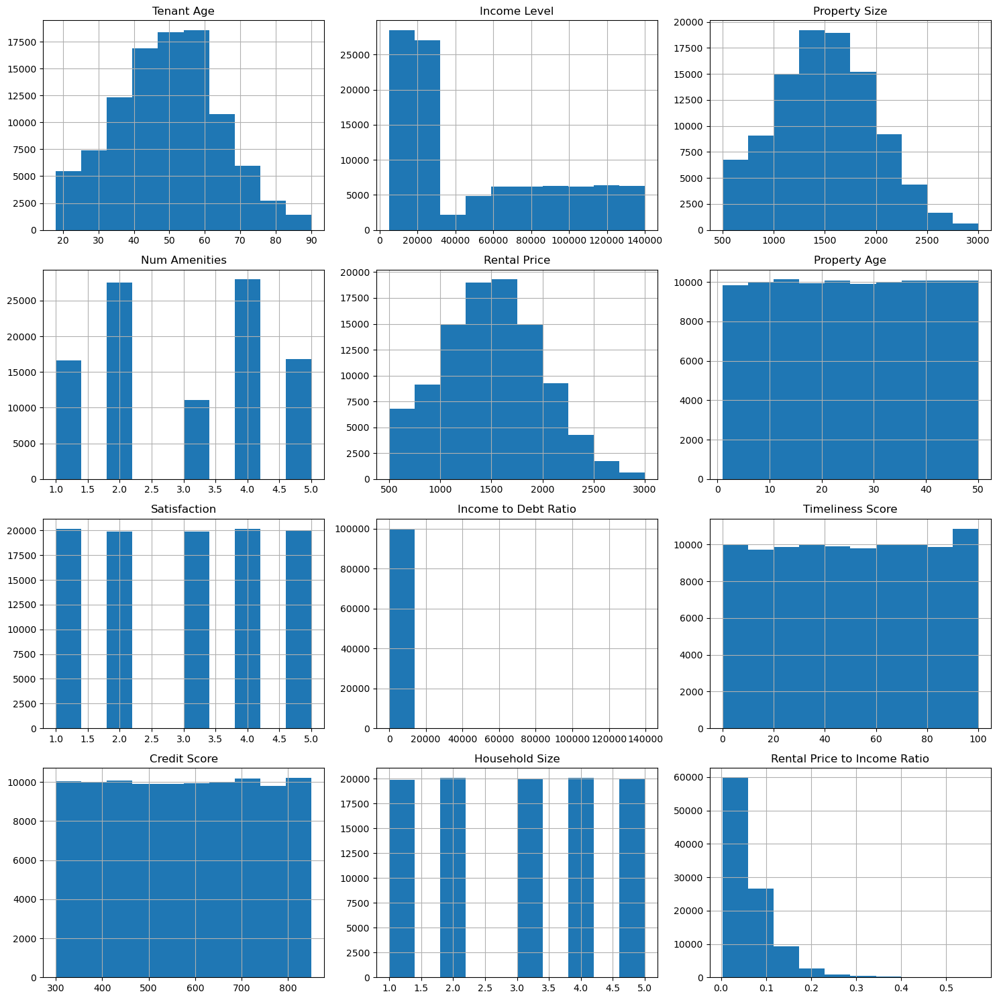

In [15]:
df.hist(figsize=(15,15))
plt.tight_layout()
plt.show()

### What is the overall arrears rate in the organization?

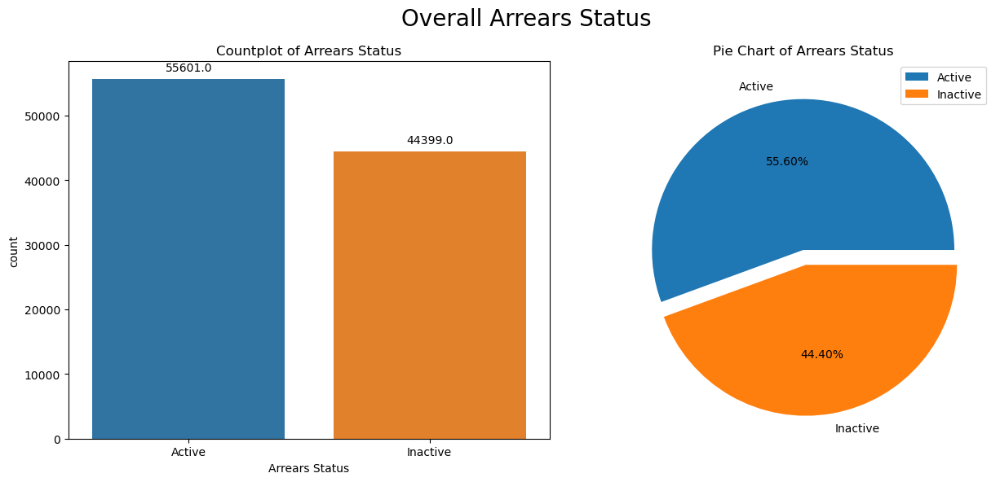

In [16]:
# Create figure and axes
fig, axes = plt.subplots(1, 2, figsize=(13, 6))

# Countplot
sns.countplot(x="Arrears Status", data=df, ax=axes[0])
axes[0].set_title("Countplot of Arrears Status")
for p in axes[0].patches:
    axes[0].annotate(f"{p.get_height()}", 
                     (p.get_x() + p.get_width() / 2, p.get_height()), 
                     ha='center', va='bottom', xytext=(0, 5), textcoords='offset points')

# Pie chart
axes[1].pie(df["Arrears Status"].value_counts(), labels=df["Arrears Status"].value_counts().index, autopct='%1.2f%%', explode=[0, 0.1])
axes[1].set_title("Pie Chart of Arrears Status")
axes[1].legend()

plt.suptitle("Overall Arrears Status", fontsize=20)

plt.tight_layout()
plt.show()

### Lets create a catalogue for all our functions

In [17]:
def TTest(val="", group=""):
    '''Apply t test between two groups seperated by "group" column in given value.'''
    uni = df[group].unique()
    result = stats.ttest_ind(df[df[group]==uni[0]][val] , df[df[group]==uni[1]][val])
    return result.statistic,stats.t.ppf(1-.05/2,result.df), result.pvalue

In [18]:
def ApplyTTest(group=""):
    '''Apply t test between all groups seperated by "group" column in all numerical value.'''
    T_Score = {}
    CriticalT = {}
    p_values = {}

    for col in df.select_dtypes("number").columns:
        T_Score[col],CriticalT[col],p_values[col] =TTest(col, group)
    columns = list(T_Score.keys())
    values = list(T_Score.values())
    critical = list(CriticalT.values())

    test_df = pd.DataFrame(
        {"Features":columns,
        "T Value":values,
        "Critical Value":critical}
                          )

    test_df["P_value"] =  [format(p, '.20f') for p in list(p_values.values())]
    test_df["P_value"] = test_df["P_value"].astype(float)
    test_df["Result"] = test_df["P_value"].map(lambda x:"Can't Reject" if x > 0.05 else "Reject")
    return test_df, p_values

In [19]:
def CalcMEE(cat="", num="", t=1.96):
    '''Calculate max estimation error in num between cat groups.'''    
    #t= 1.96 -> 0.95 CI
    n ={}
    std= {}
    EstError ={}
    Average = {}
    for col in df[cat].unique():
        group = df[df[cat] == col][num]
        Q1, Q3 = group.quantile([0.25, 0.75])
        IQR = Q3 - Q1
        upper = Q3 +1.5*IQR
        lower = Q1 - 1.5*IQR
        mask = group.between(lower, upper)
        group = group[mask]
        n[col] = len(group)
        std[col] = group.std()
        Average[col] = group.mean()
        t= stats.t.ppf(q=1-.05/2,df=len(group)-1)        
        EstError[col] = t* std[col] / np.sqrt(n[col])
    columns = list(n.keys())
    N = list(n.values())
    Std = list(std.values())
    E = list(EstError.values())
    Avg = list(Average.values())
    test_df = pd.DataFrame(
        {cat:columns,
        "Total number":N,
        "Standard Deviation":Std,
         "Mean":Avg,
        "Max Error":E,
        }
                          )
    test_df["Max Error"] = ["+/- "+ str(round(e,4)) for e in E]
    return test_df

In [20]:
def SpecialCalcMEE(cat="", num="", t=1.96):
    '''Same as CalcMME but divide groups by Arrears status also.'''    
    #t= 1.96 -> 0.95 CI
    n ={}
    std= {}
    EstError ={}
    Average = {}
    columns=[]
    
    Att =df[df["Arrears Status"]=="Active"]
    NoAtt =df[df["Arrears Status"]=="Inactive"]

    for col in df[cat].unique():
        group = Att[Att[cat] == col][num]
        colname = col+"-Yes"
        columns.append(colname)
        Q1, Q3 = group.quantile([0.25, 0.75])
        IQR = Q3 - Q1
        upper = Q3 +1.5*IQR
        lower = Q1 - 1.5*IQR
        mask = group.between(lower, upper)
        group = group[mask]
        n[colname] = len(group)
        std[colname] = group.std()
        Average[colname] = group.mean()
        t= stats.t.ppf(q=1-.05/2,df=len(group)-1)
        EstError[colname] = t* std[colname] / np.sqrt(n[colname])
        
        
        group = NoAtt[NoAtt[cat] == col][num]
        colname = col+"-No"
        columns.append(colname)
        Q1, Q3 = group.quantile([0.25, 0.75])
        IQR = Q3 - Q1
        upper = Q3 +1.5*IQR
        lower = Q1 - 1.5*IQR
        mask = group.between(lower, upper)
        group = group[mask]
        n[colname] = len(group)
        std[colname] = group.std()
        Average[colname] = group.mean()
        t= stats.t.ppf(q=1-.05/2,df=len(group)-1)
        EstError[col] = t* std[colname] / np.sqrt(n[colname])
        
    N = list(n.values())
    Std = list(std.values())
    E = list(EstError.values())
    Avg = list(Average.values())
    
    test_df = pd.DataFrame(
        {cat:columns,
        "Total number":N,
        "Standard Deviation":Std,
         "Mean":Avg,
        "Max Error":E,
        }
                          )
    test_df["Max Error"] = ["+/- "+ str(round(e,4)) for e in E]
    return test_df

In [21]:
def Plot(dep=""):
    '''Plot Arrears status per Employment Status.'''
    Employment_Status=df.groupby(['Employment Status','Arrears Status'])["Tenant Age"].count().reset_index(name='Counts')
    Employment_Status=Employment_Status[Employment_Status["Employment Status"]==dep]
    fig, axes = plt.subplots(1,2,figsize=(13,6))
    sns.barplot(x="Arrears Status",y="Counts", data=Employment_Status,ax =axes[0])
    for container in axes[0].containers:
        axes[0].bar_label(container)
    axes[1].pie(Employment_Status["Counts"], labels=Employment_Status["Arrears Status"].value_counts().index,autopct='%1.2f%%',explode=[0, 0.1])
    axes[1].legend()
    plt.suptitle(dep,fontsize=20)

In [22]:
def ChiSquared(cat1="", cat2="Arrears Status"):
    '''Do Chi square test between two given categories features.'''
    contingency_table = pd.crosstab(df[cat1], df[cat2])
    chi2, p_value, deg, _ = stats.chi2_contingency(contingency_table)
    CriticalChi = stats.chi2.ppf(0.95, deg)
    return chi2,CriticalChi, p_value

In [23]:
def plotP(p_values,st="", ISchi = False, tit =""):
    '''Plot p values of results of ANOVA test or chi.'''
    plt.figure(figsize=(12,6))
    keys = list(p_values.keys())
    values = list(p_values.values())
    sorted_value_index = list(reversed(np.argsort(values)))
    sorted_dict = {keys[i]: values[i] for i in sorted_value_index}
    keys = list(sorted_dict.keys())
    values = list(sorted_dict.values())
    
    sns.barplot(x=keys, y=values, palette='rocket')
    if tit =="": 
        if ISchi:
            plt.title(f"P_scores Comparison according Chi Square test between Categorical variables and Atrrition")
        else:
            plt.title(f"Anova Test P_score Comparison within {st} Groups")
    else:
        plt.title(tit)

    plt.axhline(y=0.05,color='red',linestyle ="--", label="P_value = 0.05")
    plt.legend()

    plt.xticks(rotation=90)

    for index,value in enumerate(values):
        plt.text(index,value,round(value,3), ha="center", va="bottom")
    plt.show()

In [24]:
def SingleANOVA(st="", num=""):
    '''Apply ANOVA test to all numerical values of groups based on given cat feature st.'''
    f_scores = {}
    p_values = {}

    Arg = []

    for col in df[st].unique():
        Arg.append(df[num][df[st] == col])

    f_score, p_value = stats.f_oneway(*Arg)
    dof_within = len(df) - len(Arg) 
    dof_between = len(Arg) -1 
    CriticalF = stats.f.ppf(1-0.05,dof_between,dof_within )
    
    return f_score,p_value, CriticalF

In [25]:
def SpecialSingleANOVA(st="", num=""):
    '''Same as SingleANOVA function but it divide groups by arrears risk and the given st.'''
    f_scores = {}
    p_values = {}

    Arg = []
    
    Att = df[df["Arrears Status"]=="Active"]
    for col in Att[st].unique():
        Arg.append(Att[num][Att[st] == col])

        
    NoAtt = df[df["Arrears Status"]=="Inactive"]
    for col in NoAtt[st].unique():
        Arg.append(NoAtt[num][NoAtt[st] == col])
    
    f_score, p_value = stats.f_oneway(*Arg)
    dof_within = len(df) - len(Arg) 
    dof_between = len(Arg) -1 
    CriticalF = stats.f.ppf(1-0.05,dof_between,dof_within )
    
    return f_score,p_value, CriticalF

In [26]:
def ANOVA(st=""):
    '''Apply ANOVA test to all numerical values of groups based on given cat feature st.'''
    f_scores = {}
    p_values = {}
    CriticalF = {}


    for num in df.select_dtypes("number").columns:
        Arg = []
        
        f_scores[num],p_values[num], CriticalF[num] = SingleANOVA(st, num)
    
    plotP(p_values,st)
    return f_scores,p_values

In [27]:
def SpecialANOVA(st=""):
    '''Same as ANOVA function but it divide groups by arrears status and the given st.'''
    f_scores = {}
    p_values = {}
    CriticalF = {}


    for num in df.select_dtypes("number").columns:
        Arg = []
        
        f_scores[num],p_values[num], CriticalF[num] = SpecialSingleANOVA(st, num)
    
    plotP(p_values,st)
    return f_scores,p_values

In [28]:
def PlotErrors(p_values,st ="" ,ISchi = False):
    '''Plot error bar between given p values with p = 0.5'''
    plt.figure(figsize=(12,6))

    x= list(p_values.keys())
    y= list(p_values.values())
    y_errormin =len(x) *[0.5]
    y_errormax =len(x) *[0.45]

    y_error =[y_errormin, y_errormax]

    plt.errorbar(x, y,
                 yerr = y_error,
                 fmt='o',capsize=10)
    plt.xticks(rotation=90)

    plt.axhline(y=0.5,color='red')
    if ISchi:
        plt.title(f"Chi Square P_score Error bar between Categorical features and Arrears Status")
    else:
        plt.title(f"ANOVA Test P_score Comparison within {st} Groups")


In [29]:
def PlotChi(keys,values):
    '''Bar plot for chi square results.'''
    plt.figure(figsize=(12,6))
    sorted_value_index = list(reversed(np.argsort(values)))
    sorted_dict = {keys[i]: values[i] for i in sorted_value_index}
    keys = list(sorted_dict.keys())
    values = list(sorted_dict.values())
    
    sns.barplot(x=keys, y=values, palette="mako")
    plt.xticks(rotation=90)
    plt.title("Chi2 Statistic Value of each Categorical Columns with Arrears Status",fontweight="black")
    for index,value in enumerate(values):
        plt.text(index,value,round(value,2),ha="center",va="bottom")
    plt.show()

In [30]:
def AddPercentage(Df, st=""):
    '''Add percentage column to given Df to use in annot bar plot.'''
    lenght = len(Df[st])
    Df["percent"]=lenght*[""]
    i=0
    while i <lenght :
        Sum = Df.iloc[i,2] +Df.iloc[i+1,2]
        prc1 = round((Df.iloc[i,2] / Sum) * 100 , 2)
        Df.iloc[i,3] = str(prc1) + ' %'
        prc2= round( (Df.iloc[i+1,2] / Sum )* 100,2)
        Df.iloc[i+1,3] = str(prc2) + ' %'
        i =i+2 
    return Df

In [31]:
def PlotPies(st=""):
    '''Plot four beside pie charts.'''
    bus=df.groupby([st,'Arrears Status'],as_index=False)['Tenant Age'].count()
    bus.rename(columns={'Tenant Age':'Count'},inplace=True)
    fig=go.Figure()
    fig = make_subplots(rows=1, cols=4,
                        specs=[[{"type": "pie"}, {"type": "pie"},{"type": "pie"}, {"type": "pie"}]],
                        subplot_titles=('Very High', 'High','Medium','Low'))

    fig.add_trace(go.Pie(values=bus[bus[st]=='Very High']['Count'],labels=bus[bus[st]=='Very High']['Arrears Status'],pull=[0,0.1],showlegend=False)
                  ,row=1,col=1)
    fig.add_trace(go.Pie(values=bus[bus[st]=='High']['Count'],labels=bus[bus[st]=='High']['Arrears Status'],pull=[0,0.1],showlegend=False)
                  ,row=1,col=2)
    fig.add_trace(go.Pie(values=bus[bus[st]=='Medium']['Count'],labels=bus[bus[st]=='Medium']['Arrears Status'],pull=[0,0.1],showlegend=False)
                  ,row=1,col=3)
    fig.add_trace(go.Pie(values=bus[bus[st]=='Low']['Count'],labels=bus[bus[st]=='Low']['Arrears Status'],pull=[0,0.1],showlegend=True)
                  ,row=1,col=4)

    fig.update_layout(title_x=0.5,template='simple_white',showlegend=True,
                      legend_title_text="A",title_text=f"<b style='color:black; font-size:100%;'>Tenant Arrears Status based on {st}",
                      font_family="Times New Roman",title_font_family="Times New Roman")
    fig.show()


In [32]:
def ShowHist():
    '''Plot histogram to show the relation between Age and Arrears Status and Gender'''
    fig, axes = plt.subplots(1, 3, sharex=True, figsize=(15,5))
    fig.suptitle('Arrears Status Age Distribution by Gender')

    sns.histplot(ax=axes[0],x=" Tenant Age",hue="Arrears Status",data=df,kde=True,palette=["r","b"])
    axes[0].set_title('Overall')

    sns.histplot(ax=axes[1],x="Tenant Age",hue="Arrears Status",data=df[df["Gender"]=="Male"].drop([1]),kde=True,palette=["r","b"])
    axes[1].set_title('Male')

    sns.histplot(ax=axes[2],x="Tenant Age",hue="Arrears Status",data=df[df["Gender"]=="Female"],kde=True,palette=["r","b"])
    axes[2].set_title('Female')
    plt.show()

In [33]:
def ShowBox():
    '''Plot boxplot to show the relation between Age and Arrears Status and Gender'''
    fig, axes = plt.subplots(1, 3, sharex=True, figsize=(15,5))
    fig.suptitle('Arrears Status Age Distribution by Gender')

    sns.boxplot(ax=axes[0],y="Tenant Age",x="Arrears Status",data=df)

    sns.boxplot(ax=axes[1],y="Tenant Age",x="Arrears Status",data=df[df["Gender"]=="Male"].drop([1]))

    sns.boxplot(ax=axes[2],y="Tenant Age",x="Arrears Status",data=df[df["Gender"]=="Female"])
    plt.show()

# Considering Technical reasons

## Employment Status
<a id="job"></a>

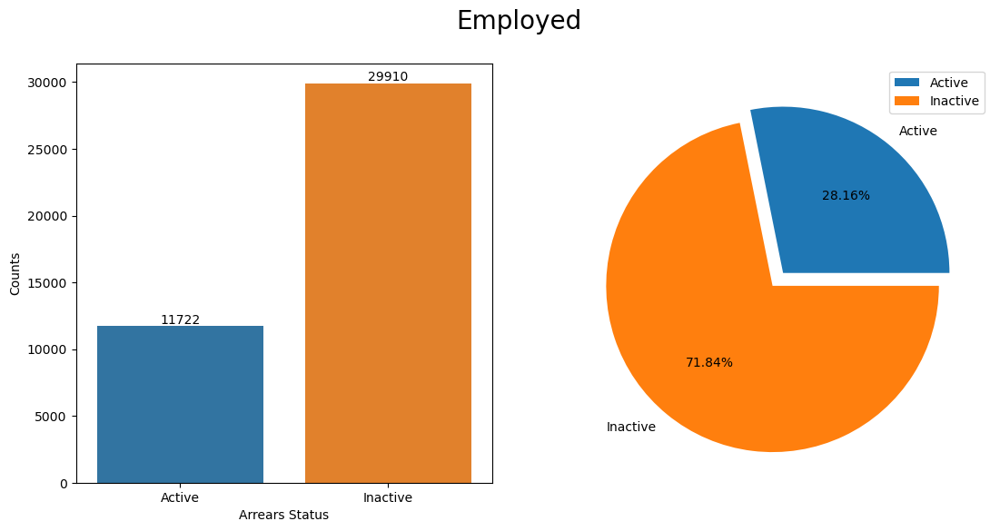

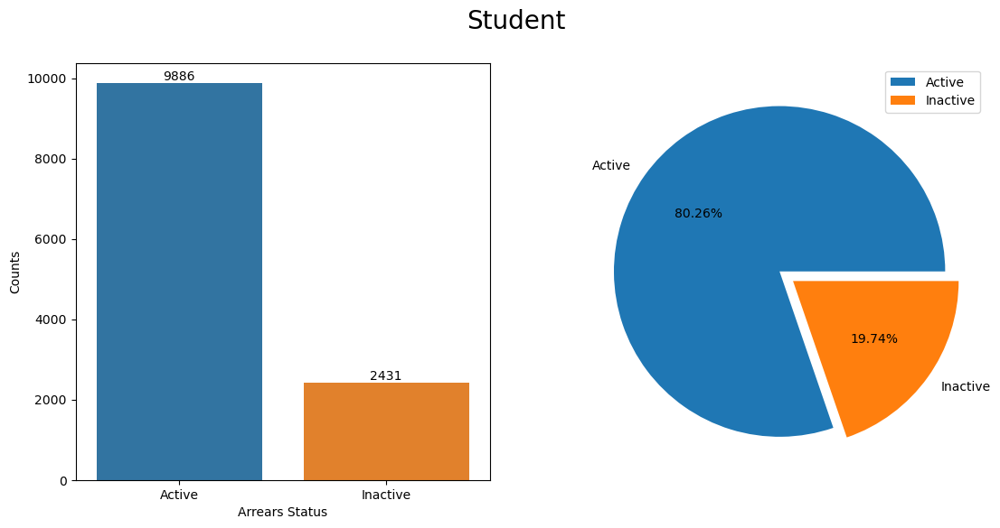

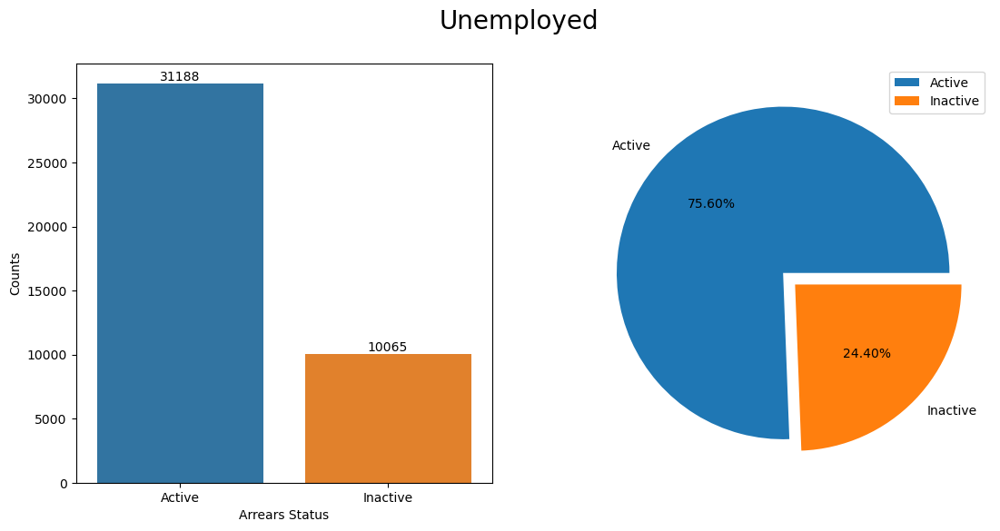

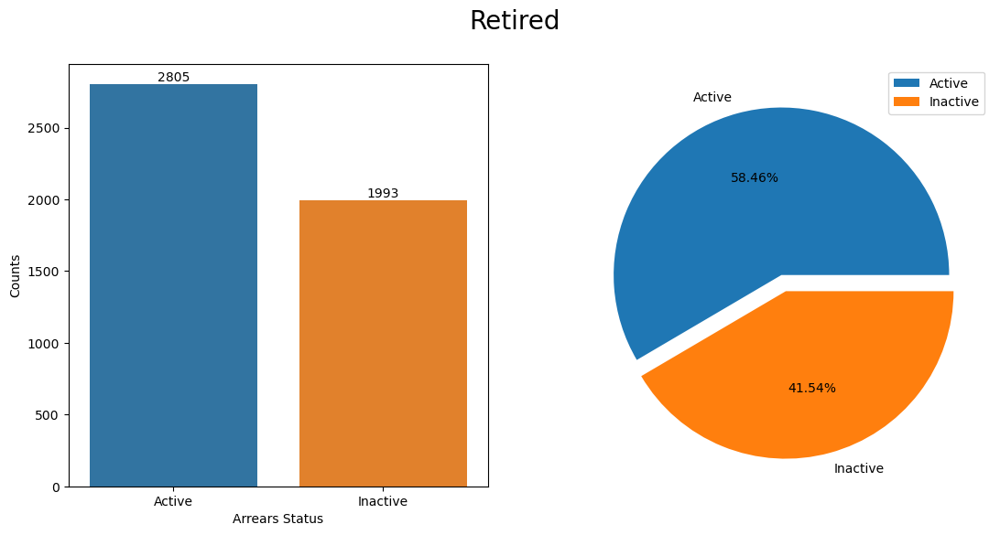

In [34]:
for dep in set(df["Employment Status"]):
    Plot(dep)

### Does employment status has an effect on the chances of running into arrears ?

To answer this question we will do Chi square test.

Null Hypothesis  𝐻0

  : Employment Status has no effect on the Chance of running into Arrears .
        
Alternative Hypothesis  𝐻𝑎

  : Employment Status has a significant effect on the Chance of running into Arrears.

In [35]:
pd.crosstab(df['Employment Status'], df['Arrears Status'])

Arrears Status,Active,Inactive
Employment Status,,
Employed,11722,29910
Retired,2805,1993
Student,9886,2431
Unemployed,31188,10065


In [36]:
chi2,CriticalChi, p_value = ChiSquared("Employment Status")

In [37]:
print(chi2,CriticalChi, p_value)

22437.972785273203 7.814727903251179 0.0


Chi-Square Statistic (X²):

The X² value of 22437.972 suggests the observed relationship between the variables (Employment Status and Arrears Status) is very strong.

Critical Chi-Square Value (X²c):

The critical chi-square value (X²c) of 7.815 indicates the threshold beyond which we would reject the null hypothesis.

P-Value (Pvalue):

The p-value of 0.00 is considerably higher than the common significance level of 0.05. A low p-value indicates strong evidence against the null hypothesis. Therefore we reject null hypothesis

# Is there a significant difference among groups of different Employment status?
- **To answer this question we will do Analysis of Variance `ANOVA` test.** 

>#### `Null hypothesis` ($H_0$)  : There is no significant difference among the groups.
>#### `Alternative hypothesis` ($H_a$) : There is a significant different among groups. 

C:\Users\Dell\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


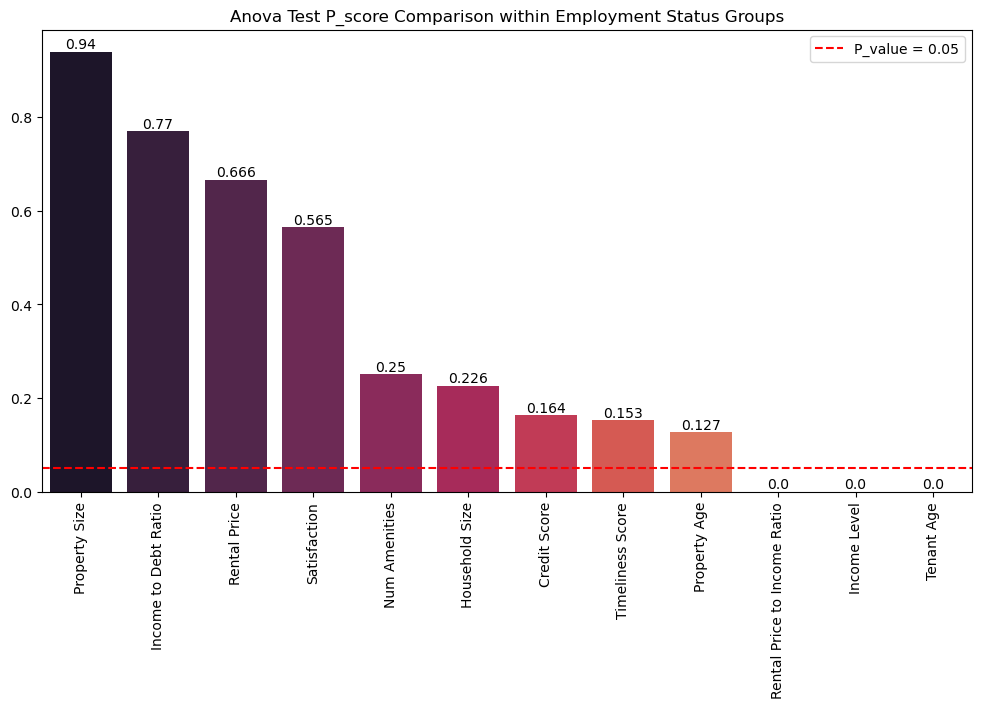

In [38]:
f_scores,p_values = ANOVA("Employment Status")

We will reject our null hypothesis for Tenant Age, income Level and rental price to income ratio as the test show there is a significant difference in groups from each department 

But **which pair of groups between all the groups that has a significant difference in Tenant Age?**  
to know that let's do **`post_hoc`** test by help of T_test

In [39]:
sp.posthoc_ttest(df, val_col='Tenant Age', group_col='Employment Status')

,Unemployed,Employed,Student,Retired
Unemployed,1.000000,0.596652,0.0,0.0
Employed,0.596652,1.000000,0.0,0.0
Student,0.000000,0.000000,1.0,0.0
Retired,0.000000,0.000000,0.0,1.0


It is seen that there is a significant difference in Monthly income between Employed and Retired tenants, Employed and Student tenants, Unemployed and Retired tenants, unemployed and Student tenants. 
We see in our EDA analysis that Employed tenants have the lowest active arrears status and tenants who are students have the highest one, so may be the difference between the age and also differences in income level between Tenants make them run into arrears.

<div style="border-radius:30px; border:Indigo solid;color : Indigo; padding: 15px; background-color: rgba(135, 206, 235, 0.75); text-align:left">

> ## Recap:
>> * Employed tenants has the lowest active arrears status.
>> * Majority of the tenants are employed.
>> * Student Tenants have the highest active arrears status.
>> * Minority of the tenants are retired.  
>> * Employment Status have a significant effect on the chances to run into an active arrear. 
>> * There is a significant difference in Tenants age between departments groups especially Employed and Retired tenants, Employed and Student tenants, Unemployed and Retired tenants, unemployed and Student tenants

## Highest Education
<a id="job"></a>

#### Which education Level has the highest active arrears status and which has the lowest?

In [40]:
Edulevel = df.groupby(['Highest Education', 'Arrears Status'])["Tenant Age"].count().reset_index(name='Counts')
Edulevel = AddPercentage(Edulevel,"Highest Education")

In [41]:
fig =px.bar(Edulevel, y ="Counts", x ="Highest Education",color="Arrears Status", text='percent')
fig.show()

C:\Users\Dell\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  sf: grouped.get_group(s if len(s) > 1 else s[0])


In [42]:
ChiSquared("Highest Education")

(531.3678114896178, 7.814727903251179, 7.592739622060708e-115)

##### we reject alternative hypothesis ( 𝐻𝑎) : There is  significant different among groups

In [43]:
px.box(df, x="Highest Education", y="Tenant Age", title="Age distribution by different education level")

<div style="border-radius:30px; border:Indigo solid;color : Indigo; padding: 15px; background-color: rgba(135, 206, 235, 0.75); text-align:left">

> ## Recap:
>> * Most tenants are Bachelor degree holders in this organization.
>> * Highest active arrears status rates are those with high school certification.  
>> * Only 2% of the total tenants have the high school certification as highest education level 
>> * Lowest active arrears rates are those with bachelors degree.
>> * There is a significant difference between different education levels in monthly income level and values that related with time and experience such that age.


#### Monthly Income Level

C:\Users\Dell\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\Dell\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

C:\Users\Dell\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

C:\Users\Dell\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence t

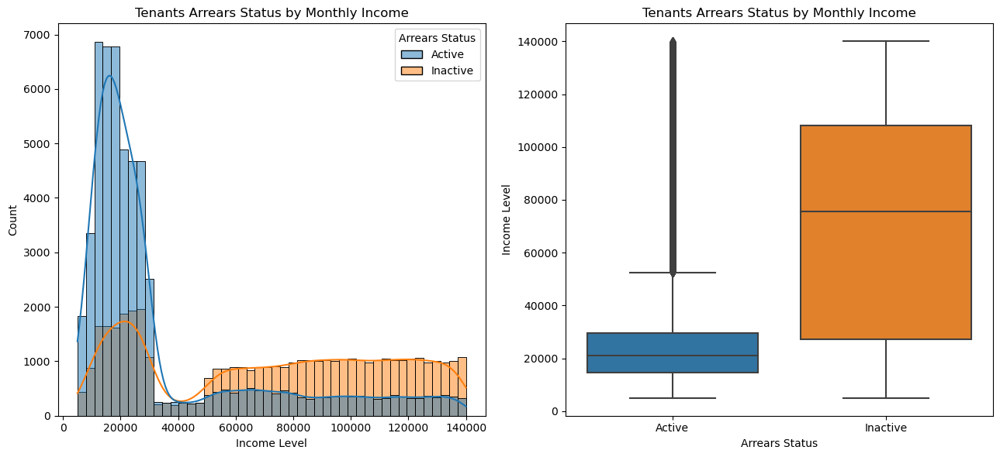

In [44]:
plt.figure(figsize=(13,6))
plt.subplot(1,2,1)
sns.histplot(x="Income Level", hue="Arrears Status", kde=True,data=df )
plt.title("Tenants Arrears Status by Monthly Income")

plt.subplot(1,2,2)
sns.boxplot(x="Arrears Status",y="Income Level",data=df)
plt.title("Tenants Arrears Status by Monthly Income")
plt.tight_layout()
plt.show()


## To know if the Monthly income plays significant role in arrears status
- **Let's do `T Test` between tenants in active arrears status and the others whose arrears is inactive.** 

>#### `Null hypothesis` ($H_0$)  : Monthly income does not affect the arrears status.
>#### `alternative hypothesis` ($H_a$) : Monthly income has a significant effect on arrears status. 

In [45]:
TTest("Income Level", "Arrears Status")

AttributeError: 'Ttest_indResult' object has no attribute 'df'

> `T Value` = $505.915$  
> `Critical value` = $-1.96$  
> `Pvalue` = $0.000$

Since $T < |T_C|$ or $P << 0.05$ We Will Accept Alternative Hypothesis that says ***" Monthly income has a significant effect on arrears status "***.

### Let's execute `ANOVA` test to know what categorical variables depend on monthly income

In [46]:
p_values = {}
for st in df.select_dtypes("object").columns:
    _,p_values[st],_ = SingleANOVA(st, "Income Level")

C:\Users\Dell\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1765: FutureWarning:

unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.



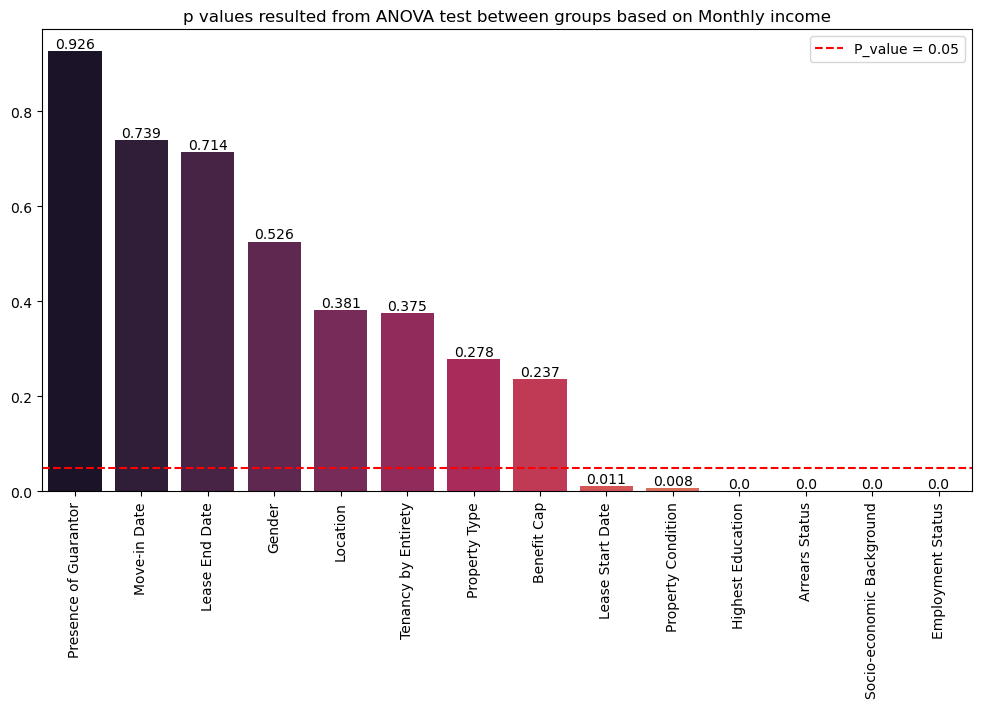

In [47]:
plotP(p_values,tit="p values resulted from ANOVA test between groups based on Monthly income")

> ### ANOVA test results showes that there is significant difference in monthly income between defferent groups   


### The next graphs agree with what we conclude from ANOVA test:

In [48]:
SingleANOVA("Highest Education", "Income Level")

(104.62422458045529, 1.2623359055632596e-67, 2.6049980651708884)

In [49]:
sp.posthoc_ttest(df, val_col='Income Level', group_col='Highest Education').apply(lambda x:round(x, 5))

,PhD,Master,Bachelor,High School
PhD,1.00000,0.00057,0.00000,0.0
Master,0.00057,1.00000,0.00022,0.0
Bachelor,0.00000,0.00022,1.00000,0.0
High School,0.00000,0.00000,0.00000,1.0


In [50]:
fig1=px.box( df,x="Highest Education" ,y="Income Level")
fig2=px.box( df,x="Highest Education" ,y="Income Level", color="Arrears Status")
fig1.show()
fig2.show()

C:\Users\Dell\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [51]:
CalcMEE('Highest Education',"Income Level" ) #95% CL

,Highest Education,Total number,Standard Deviation,Mean,Max Error
0,PhD,33499,40348.230958,52935.022180,+/- 432.0882
1,Master,23696,41315.025800,51742.624283,+/- 526.0667
2,Bachelor,36434,41983.352394,50457.032717,+/- 431.1081
3,High School,6371,40709.068559,43223.254748,+/- 999.8112


In [52]:
result= SpecialCalcMEE('Highest Education',"Income Level")

In [53]:
errors = [float(x[3:]) for x in result["Max Error"]]
px.bar(result, x="Highest Education", y="Mean", error_y= errors, title="Bar Plot of mean Monthly income with max error of estimation")

In [54]:
px.box( df,x="Employment Status" ,y="Income Level")

In [55]:
CalcMEE("Employment Status","Income Level" )

,Employment Status,Total number,Standard Deviation,Mean,Max Error
0,Unemployed,41253,5768.255611,20040.369961,+/- 55.6644
1,Employed,41632,25940.489830,95206.783124,+/- 249.1869
2,Student,12317,4288.113087,12576.810262,+/- 75.7364
3,Retired,4798,8647.308894,34974.503960,+/- 244.742


In [56]:
result= SpecialCalcMEE('Employment Status',"Income Level")

In [57]:
errors = [float(x[3:]) for x in result["Max Error"]]
px.bar(result, x="Employment Status", y="Mean", error_y= errors,title="Bar Plot of mean Monthly income with max error of estimation")

<div style="border-radius:30px; border:Indigo solid;color : Indigo; padding: 15px; background-color: rgba(135, 206, 235, 0.75); text-align:left">

> ## Recap:
>> * Most of the tenants are getting paid less than 50000.
>> * Monthly income plays significant role in arrears status.
>> * there is significant difference in monthly income between defferent groups of **`Department`, `Highest Education`, `Socioeconomical Background`, `Arrears status`**   
>> * Employed tenants in general are varying a lot in their monthly income.

### GENDER

In [58]:
AttOvered =df.groupby(["Gender",'Arrears Status'],as_index=False)['Tenant Age'].count()
AttOvered.rename(columns={'Tenant Age':'Count'},inplace=True)
AttOvered=AddPercentage(AttOvered,"Gender")
Overed =df.groupby(["Gender"],as_index=False)['Tenant Age'].count()
Overed.rename(columns={'Tenant Age':'Count'},inplace=True)
Overed

,Gender,Count
0,Female,49705
1,Male,50295


In [59]:
AttOvered

,Gender,Arrears Status,Count,percent
0,Female,Active,23859,48.0 %
1,Female,Inactive,25846,52.0 %
2,Male,Active,31742,63.11 %
3,Male,Inactive,18553,36.89 %


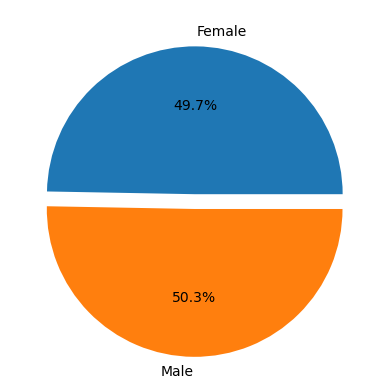

In [60]:
plt.pie(Overed["Count"], labels=Overed["Gender"], autopct='%1.1f%%',explode=[0, 0.1])
plt.show()

In [61]:
px.bar(AttOvered,x="Gender", y="Count", color="Arrears Status", text="percent")

C:\Users\Dell\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



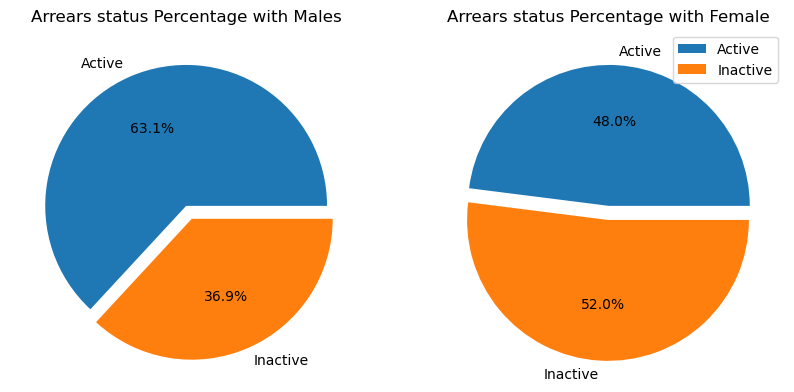

In [62]:
fig = plt.figure(figsize=(10, 10))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

ax1 = plt.subplot(gs[0])
ax2 = plt.subplot(gs[1])
ax1.pie(AttOvered[AttOvered["Gender"]== "Male"]["Count"], labels=AttOvered[AttOvered["Gender"]== "Male"]["Arrears Status"], autopct='%1.1f%%',explode=[0, 0.1])
ax2.pie(AttOvered[AttOvered["Gender"]== "Female"]["Count"], labels=AttOvered[AttOvered["Gender"]== "Female"]["Arrears Status"], autopct='%1.1f%%',explode=[0, 0.1])

# Set titles for the subplots
ax1.set_title("Arrears status Percentage with Males")
ax2.set_title("Arrears status Percentage with Female")
ax2.legend()
# Display the pie charts
plt.show()


In [63]:
ChiSquared("Gender")

(2311.575112999417, 3.841458820694124, 0.0)

> $X^2 = 2311.57$  
> $X^2_c = 3.8414$  
> $Pvalue = 0.000$

Since $X^2 >> X^2_c$ or $P << 0.05$ We Will reject our Null Hypothesis and accept the alternative that says ***" Overtime has a significant effect on the effect to run into arrears "***.

### are the male gender getting paid more than the other?

In [64]:
CalcMEE("Gender","Income Level")

,Gender,Total number,Standard Deviation,Mean,Max Error
0,Female,49705,41291.719690,51214.157187,+/- 363.0125
1,Male,50295,41240.686227,51048.627816,+/- 360.4309


In [65]:
TTest("Income Level","Gender" )

AttributeError: 'Ttest_indResult' object has no attribute 'df'

>  $1- \alpha = 95\%$  
> `T Value` = $0.634$  
> `Critical value` = $1.96$  
> `P_value` = $0.525$

Since $T < |T_C|$ or $P > 0.05$ We can say that ***" There is no significant difference in monthly income between male and female tenants"***.

In [66]:
px.box(df, x="Gender", y="Income Level", points="all")

# Features related with experience:

In [ ]:
 def Countdf(st=""):
        dfToPlot=df.groupby([st,'Arrears Status'])["Tenant Age"].count().reset_index(name='Counts')
        dfToPlot["Percentage"]=round((dfToPlot["Counts"]/ sum(dfToPlot["Counts"])) * 100, 2)
        dfToPlot["Percentage"]=dfToPlot["Percentage"].astype(str).apply(lambda x: x +"%")
        return dfToPlot

In [ ]:
def plotIt(dfToPlot,st=""):
    ax= sns.barplot(
        x = st,
        y = 'Counts',
        hue = 'Arrears Status',
        data = dfToPlot)
    for i in ax.containers:
        ax.bar_label(i,) 

# Does Location affects the arrears status rate?

In [ ]:
CalcMEE("Location","Income Level")

In [ ]:
px.box(df, x="Location", y="Income Level", points="all")

# Does Property age affects  the arrears status?

In [ ]:
sns.kdeplot(x=df['Property Age'],color='blue',fill=True,label='Property Age')
plt.axvline(x=df['Property Age'].mean(),color='red',linestyle ="--",label='Mean Age: 36.923')
plt.legend()
plt.title('Distribution of Property Age')
plt.show()

### Is there a significant association between age and attrition?


In [ ]:
TTest("Property Age", "Arrears Status")

### Does Tenant Age affects arrears status?

In [ ]:
sns.kdeplot(x=df['Tenant Age'],color='blue',fill=True,label='Tenant Age')
plt.axvline(x=df['Tenant Age'].mean(),color='red',linestyle ="--",label='Mean Age: 36.923')
plt.legend()
plt.title('Distribution of Tenant Age')
plt.show()

### Are elderly tenants getting more monthly income?

In [ ]:
c= stats.pearsonr(df["Income Level"], df["Tenant Age"])
c

In [ ]:

slope, intercept, r_value, p_value, std_err = stats.linregress(df['Tenant Age'], df['Income Level'])
line = slope * df['Tenant Age'] + intercept

X =np.array(df["Tenant Age"])
y=df["Income Level"]
X_with_intercept = sm.add_constant(X)
SMmodel = sm.OLS(y, X_with_intercept).fit()

# Get predictions and prediction intervals
predictions = SMmodel.get_prediction(X_with_intercept)
pi = predictions.conf_int(obs=True)

max_error =(pi[:,1] - pi[:,0])/2   #(upper - lower)/2    0.95 CI
max_error_df = pd.DataFrame({
    'Age': df['Tenant Age'],
    'Upper_bound': line + max_error,
    'Lower_bound': line - max_error
})

fig = px.scatter(df, x='Tenant Age', y='Income Level', trendline='ols', title='Relationship between Age and Monthly Income with Prediction Interval CI = 95%')
fig.update_traces(line=dict(color="rgba(255, 0, 0,0.05)", width=180))

fig.add_trace(px.line(max_error_df, x='Age', y='Upper_bound', line_shape='linear').data[0])
fig.add_trace(px.line(max_error_df, x='Age', y='Lower_bound', line_shape='linear').data[0])
fig.add_trace(px.line(x=df['Tenant Age'], y=line, line_shape='linear').data[0])

fig.show()


The red area define the prediction Interval region PI.¶
Corrlation statistis Pr=0.5
 which indicate that there is a moderate positive correlation between Monthly income and age.

In [ ]:
fig = px.scatter(df, x='Tenant Age', y='Income Level',color="Arrears Status", trendline='ols'
                 , opacity=0.5,
                 title='Arrears between Age and Monthly Income')

fig.show()

# <div style="padding:20px;color:white;margin:0;font-size:35px;text-align:center;display:fill;border-radius:10px;background-color:#c54E58;overflow:hidden; font-family: 'Lucida Console'"><b> Statistical Analysis </b></div>
<a id="stat"></a>

# Correlation Matrix

In [ ]:
corr = df.select_dtypes("number").corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(15, 10))
sns.heatmap(corr,
            vmax=1,
            mask=mask,
            annot=True, fmt='.2f',
            linewidths=.2, cmap=sns.color_palette("Reds"))
plt.show()

## Point biserial correlation:
<a id="bi"></a>

In [ ]:
CorrScore = {}
p_values = {}
for col in df.select_dtypes("number").columns:
    cc, p = stats.pointbiserialr(df["Arrears Status"].replace({"Active":1,"Inactive": 0}), df[col])
    CorrScore[col] = cc
    p_values[col] = p

In [ ]:
columns = list(CorrScore.keys())
values = list(CorrScore.values())

test_df = pd.DataFrame(
    {"Features":columns,
    "Corr":values}
                      )
test_df["P_value"] =  [format(p, '.20f') for p in list(p_values.values())]
test_df["P_value"] = test_df["P_value"].astype(float)
test_df["Result"] = test_df["P_value"].map(lambda x:"Can't Reject" if x > 0.05 else "Reject")
test_df

>### Reject $H_0$ for those features as they has a significant effect on Attrition 
>>```python
[
 "Age"                   , "DailyRate"
 "DistanceFromHome"      , "JobInvolvement"
 "MonthlyIncome"         , "TotalWorkingYears"
 "TrainingTimesLastYear" , "YearsAtCompany"
 "YearsInCurrentRole"    , "YearsWithCurrManager"
]
```

In [ ]:
PlotErrors(p_values)
plt.title("P values results of correlation analysis between numerical features with Arrears status")

In [ ]:
df.select_dtypes("number").corrwith(df["Arrears Status"].replace({"Active":1,"Inactive": 0})).sort_values().plot(kind='barh')

## Chi Square ( $\chi^2$ ) test summary:
<a id="chi"></a>


In [ ]:
chi2_statistic = {}
p_values = {}
criticalChis = {} 
# Perform chi-square test for each column
for col in df.select_dtypes("object").drop("Arrears Status", axis =1).columns:
    chi2, crit,p_value = ChiSquared(col)
    chi2_statistic[col] = chi2
    p_values[col] = p_value
    criticalChis[col] = crit

In [ ]:
columns = list(chi2_statistic.keys())
values = list(chi2_statistic.values())
critical = list(criticalChis.values())

test_df = pd.DataFrame(
    {"Features":columns,
    "Chi_2 Statistic":values,
    "Critical Value":critical}
                      )
test_df["P_value"] =  [format(p, '.20f') for p in list(p_values.values())]
test_df["P_value"] = test_df["P_value"].astype(float)
test_df["Result"] = test_df["P_value"].map(lambda x:"Can't Reject" if x > 0.05 else "Reject")
test_df

>#### `Alternative hypothesis` $H_a$ : There is a significant different and this categorical feature affect Attrition 

>#### `Null hypothesis` $H_0$  : There is no association between considering categorical feature and Employee Attrition
>#### `Alternative hypothesis` $H_a$ : There is a significant different and this categorical feature affect Attrition 

In [ ]:
PlotChi(columns,values)

lower $\chi^2$ indicates no relation -> (Accept region) 
but we can not certain of that untill we compare with critical value $\chi^2_c$ 

In [ ]:
plotP(p_values,"",True)

# <div style="padding:20px;color:white;margin:0;font-size:35px;text-align:center;display:fill;border-radius:10px;background-color:#c54E58;overflow:hidden; font-family: 'Lucida Console'"><b> predictive Model </b></div>
<a id="model"></a>


In [ ]:
def evaluate(model, X_train, X_test, y_train, y_test):
    y_test_pred = model.predict(X_test)
    y_train_pred = model.predict(X_train)
    acc_train = accuracy_score(y_train, y_train_pred)
    acc_test = accuracy_score(y_test,y_test_pred)
    testconfusion = confusion_matrix(y_test, y_test_pred)
    trainconfusion = confusion_matrix(y_train, y_train_pred)

    print("TRAINIG RESULTS: \n===============================")
    
    print(f"CONFUSION MATRIX:\n{trainconfusion}")
    print(f"ACCURACY SCORE:\n{acc_train:.4f}")
    print("precision score:", round(precision_score(y_train,y_train_pred),2))
    print("Recall Accuracy:", round(recall_score(y_train,y_train_pred),2))
    print("Area Under Curve AUC:", round(roc_auc_score(y_train,y_train_pred),2))
    
    print("\n\nTesting RESULTS: \n===============================")
    
    print(f"CONFUSION MATRIX:\n{testconfusion}")
    print(f"ACCURACY SCORE:\n{acc_test:.4f}")
    print("precision score:", round(precision_score(y_test,y_test_pred),2))
    print("Recall Accuracy:", round(recall_score(y_test,y_test_pred),2))
    print("Area Under Curve AUC:", round(roc_auc_score(y_test,y_test_pred),2))
  

In [ ]:
data =df.copy()
# Exclude date columns and Tenant ID from the dataset
date_columns = ['Move-in Date', 'Lease Start Date', 'Lease End Date']
data = data.drop(columns=['Income to Debt Ratio'] + date_columns)

In [ ]:
data["Arrears Status"]= data["Arrears Status"].replace({"Active":1, "Inactive": 0})

In [ ]:

# Separate features and target variable
X = data.drop(columns=['Arrears Status'])
y = data['Arrears Status']

In [ ]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.utils import resample
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay, accuracy_score, classification_report, roc_auc_score, precision_score , recall_score
from sklearn.ensemble import AdaBoostClassifier
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score

from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline, make_pipeline
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import pandas as pd
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier

In [ ]:

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define categorical and numeric columns
categorical_cols = ['Gender', 'Employment Status', 'Socio-economic Background', 'Highest Education',
                    'Location', 'Property Type', 'Property Condition', 'Tenancy by Entirety', 'Benefit Cap',
                    'Presence of Guarantor']
numeric_cols = [col for col in X_train.columns if col not in categorical_cols]

# Preprocess numeric columns
scaler = StandardScaler()
X_train_numeric = scaler.fit_transform(X_train[numeric_cols])
X_test_numeric = scaler.transform(X_test[numeric_cols])

# Preprocess categorical columns
encoder = OneHotEncoder(drop='first')
X_train_categorical = encoder.fit_transform(X_train[categorical_cols])
X_test_categorical = encoder.transform(X_test[categorical_cols])

# Combine processed numeric and categorical data
import numpy as np
X_train_processed = np.hstack((X_train_numeric, X_train_categorical.toarray()))
X_test_processed = np.hstack((X_test_numeric, X_test_categorical.toarray()))

# Create the model dictionary
model_dict = {
    'Dummy': DummyClassifier(random_state=3),
    'Stochastic Gradient Descent': SGDClassifier(random_state=3, loss='log_loss'),
    'Random Forest': RandomForestClassifier(random_state=3),
    'Decision Tree': DecisionTreeClassifier(random_state=3),
    'AdaBoost': AdaBoostClassifier(random_state=3),
    'Gaussian Naive Bayes': GaussianNB(),
    'LinearSVC': LinearSVC(),
    'K Nearest Neighbor': KNeighborsClassifier()
}

# Function to evaluate model scores
def model_score_df(model_dict, X_train, X_test, y_train, y_test):   
    model_name, ac_score_list, p_score_list, r_score_list, f1_score_list = [], [], [], [], []
    for k,v in model_dict.items():   
        model_name.append(k)
        v.fit(X_train, y_train)
        y_pred = v.predict(X_test)
        ac_score_list.append(accuracy_score(y_test, y_pred))
        p_score_list.append(precision_score(y_test, y_pred, average='macro'))
        r_score_list.append(recall_score(y_test, y_pred, average='macro'))
        f1_score_list.append(f1_score(y_test, y_pred, average='macro'))
    model_comparison_df = pd.DataFrame({
        'model_name': model_name,
        'accuracy_score': ac_score_list,
        'precision_score': p_score_list,
        'recall_score': r_score_list,
        'f1_score': f1_score_list
    })
    model_comparison_df = model_comparison_df.sort_values(by='f1_score', ascending=False)
    return model_comparison_df

# Call the function with your data
model_comparison_df = model_score_df(model_dict, X_train_processed, X_test_processed, y_train, y_test)
model_comparison_df

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostClassifier

# Define the AdaBoostClassifier
ada_boost = AdaBoostClassifier(random_state=3)

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [50, 100, 200],  # Number of weak learners
    'learning_rate': [0.01, 0.1, 1.0]  # Learning rate of the algorithm
}

# Perform GridSearchCV to find the best hyperparameters
grid_search = GridSearchCV(estimator=ada_boost, param_grid=param_grid, scoring='f1_macro', cv=5)
grid_search.fit(X_train_processed, y_train)

# Get the best hyperparameters and the corresponding F1-score
best_params = grid_search.best_params_
best_f1_score = grid_search.best_score_

# Re-fit the AdaBoostClassifier with the best hyperparameters
best_ada_boost = AdaBoostClassifier(**best_params, random_state=3)
best_ada_boost.fit(X_train_processed, y_train)

# Evaluate the model on the test set
y_pred_test = best_ada_boost.predict(X_test_processed)
test_f1_score = f1_score(y_test, y_pred_test, average='macro')

print("Best Hyperparameters:", best_params)
print("Best F1-score on Cross Validation:", best_f1_score)
print("F1-score on Test Set:", test_f1_score)


In [ ]:
# Define categorical and numeric columns
categorical_cols = ['Gender', 'Employment Status', 'Socio-economic Background', 'Highest Education',
                    'Location', 'Property Type', 'Property Condition', 'Tenancy by Entirety', 'Benefit Cap',
                    'Presence of Guarantor']
numeric_cols = [col for col in X.columns if col not in categorical_cols]

# Create a preprocessing pipeline
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(drop='first'))
])

preprocessor = ColumnTransformer(transformers=[
    ('num', numeric_transformer, numeric_cols),
    ('cat', categorical_transformer, categorical_cols)
])

# Create the full pipeline including preprocessing and model training with best parameters
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', AdaBoostClassifier(n_estimators=200, learning_rate=1.0, random_state=42))  
])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fit the pipeline on the training data
pipeline.fit(X_train, y_train)


In [ ]:
# Make predictions on the testing data
y_pred = pipeline.predict(X_test)

# Evaluate the model performance
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")

In [ ]:
evaluate(pipeline, X_train, X_test, y_train, y_test)

In [ ]:
ConfusionMatrixDisplay.from_estimator(pipeline, X_train, y_train)

In [ ]:
ConfusionMatrixDisplay.from_estimator(pipeline, X_test, y_test)

In [ ]:
# Save the trained model
joblib.dump(pipeline, 'pipeline.joblib')

# <div style="padding:20px;color:white;margin:0;font-size:25px;text-align:center;display:fill;border-radius:10px;background-color:Tomato;overflow:hidden;font-family: 'Lucida Console' "><b> Bootstrap confidence interval </b></div>
<a id="boot"></a>


In [ ]:
numOfSumples = 50
Accuracies = list()
for i in range(numOfSumples):
    BootX_train , Booty_train = resample(X_train, y_train)
    pipeline.fit(BootX_train, Booty_train)
    y_test_pred = pipeline.predict(X_test)
    score =accuracy_score(y_test, y_test_pred)
    #print("TESTING RESULTS: \n===============================")
    #print(f"CONFUSION MATRIX:\n{confusion_matrix(y_test, y_test_pred)}")
    #print(f"ACCURACY SCORE:\n{score:.4f}")
    Accuracies.append(score)

In [ ]:
plt.errorbar(x = np.arange(1, len(Accuracies) +1 ,1), y= Accuracies, fmt='o')
plt.axhline(y=np.mean(Accuracies),color='red',linestyle ="--", label=f"Mean Accuracy = {round(np.mean(Accuracies),4)}")
plt.legend()

In [ ]:
sns.histplot(Accuracies, kde= True)

In [ ]:
# confidence intervals
alpha = 0.95
p = ((1.0-alpha)/2.0) * 100
lower = max(0.0, np.percentile(Accuracies, p))
p = (alpha+((1.0-alpha)/2.0)) * 100
upper = min(1.0, np.percentile(Accuracies, p))

In [ ]:
plt.figure(figsize=(12,6))

x= np.arange(1, len(Accuracies) +1 ,1)
y= Accuracies
y_error =(upper - lower) / 2.0
 
plt.errorbar(x, y,
             yerr = y_error,
             fmt ='o',capsize=3)
plt.xticks(rotation=90)

plt.axhline(y=np.mean(Accuracies),color='red')


In [ ]:
print('At %.1f confidence interval Accuracy =  %.1f%% +/- %.1f%%' % (alpha*100,np.mean(Accuracies)*100, (upper -lower)/2.0*100))
print('Accuracy lies between %.1f%% and %.1f%%' % (lower*100, upper*100))

# <div style="padding:20px;color:white;margin:0;font-size:25px;text-align:center;display:fill;border-radius:10px;background-color:Tomato;overflow:hidden;font-family: 'Lucida Console' "><b> Risk Level </b></div>
<a id="risk"></a>

In [ ]:
Resuls = df.copy()

In [ ]:
df['Location'].unique()

In [ ]:
Resuls["ArrearsLikelihood"] = pipeline.predict_proba(X)[:, 1]

In [ ]:
sns.histplot(Resuls["ArrearsLikelihood"], kde=True)

In [ ]:
Resuls["RiskLevel"] = Resuls["ArrearsLikelihood"].astype("object").map(lambda x:"Strong" if x > 0.4 else "Medium" if x > 0.3 else "Weak" )

In [ ]:
Resuls[['Arrears Status', 'ArrearsLikelihood', 'RiskLevel' ]][42:53]

In [ ]:
pd.crosstab(Resuls["RiskLevel"] ,Resuls["Arrears Status"])


# <div style="padding:20px;color:white;margin:0;font-size:25px;text-align:center;display:fill;border-radius:10px;background-color:Tomato;overflow:hidden;font-family: 'Lucida Console' "><b> Features importances </b></div>

<a id="import"></a>

In [ ]:
feat_imp = pd.Series(importances, index=features).sort_values()
SortedDF= pd.DataFrame(feat_imp)
MaxMin =pd.concat([SortedDF.head(7), SortedDF.tail(7)], axis=0)

MaxMin.plot(kind="barh")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Feature Importance")

In [ ]:
def make_prediction(age, gender, employment_status, income_level,
                    socio_economic_background, highest_education, location, property_type,
                    size, num_amenities, rental_price, property_age, property_condition,
                    tenancy_by_entirety, benefit_cap, satisfaction, timeliness_score, credit_score,
                    household_size, presence_of_guarantor,rental_price_income_ratio):
    data = {
        'Tenant Age': age,
        'Gender': gender,
        'Employment Status': employment_status,
        'Income Level': income_level,
        'Socio-economic Background': socio_economic_background,
        'Highest Education': highest_education,
        'Location': location,
        'Property Type': property_type,
        'Property Size': size,
        'Num Amenities': num_amenities,
        'Rental Price': rental_price,
        'Property Age': property_age,
        'Property Condition': property_condition,
        'Tenancy by Entirety': tenancy_by_entirety,
        'Benefit Cap': benefit_cap,
        'Satisfaction': satisfaction,
        'Rental Price to Income Ratio': rental_price_income_ratio,
        'Timeliness Score': timeliness_score,
        'Credit Score': credit_score,
        'Household Size': household_size,
        'Presence of Guarantor': presence_of_guarantor
    }
    df = pd.DataFrame(data, index=[0])
    prediction = pipeline.predict_proba(df)[:, 1][0]
    if prediction > 0.4:
        risk = "Strong"
    elif prediction > 0.3:
        risk = "Medium"
    else:
        risk = "Weak" 
    return f"This tenant has a {risk} Risk of having rental arrears with Probability = {round(prediction, 5)}."


In [ ]:
from ipywidgets import interact, IntSlider, Dropdown, FloatSlider

In [ ]:
interact(
    make_prediction,
    age=IntSlider(min=18, max=90, value=50),
    gender=Dropdown(options=['Male', 'Female']),
    employment_status=Dropdown(options=['Employed', 'Unemployed', 'Student', 'Retired']),
    income_level=IntSlider(min=10000, max=140000, value=70000),
    socio_economic_background=Dropdown(options=['Low', 'Medium', 'High']),
    highest_education=Dropdown(options=['High School', 'Bachelor', 'Master', 'PhD']),
    location=Dropdown(options=['West Sussex', 'West Yorkshire', 'Wiltshire', 'Worcestershire']),
    property_type=Dropdown(options=['Apartment', 'House', 'Condominium']),
    size=IntSlider(min=500, max=3000, value=1500),
    num_amenities=IntSlider(min=1, max=5, value=3),
    rental_price=IntSlider(min=500, max=3000, value=1500),
    property_age=IntSlider(min=1, max=50, value=20),
    property_condition=Dropdown(options=['New', 'Renovated', 'Outdated']),
    tenancy_by_entirety=Dropdown(options=['Yes', 'No']),
    benefit_cap=Dropdown(options=['Yes', 'No']),
    satisfaction=IntSlider(min=1, max=5, value=3),
    timeliness_score=IntSlider(min=0, max=100, value=50),
    credit_score=IntSlider(min=300, max=850, value=600),
    household_size=IntSlider(min=1, max=5, value=3),
    presence_of_guarantor=Dropdown(options=['Yes', 'No']),
    rental_price_income_ratio=FloatSlider(min=0.1, max=1.0, value=0.5)
);


In [ ]:
import gradio as gr

Inputs = [
    gr.Slider(
        18, 90,
        value=50,
        label="Tenant Age"
    ),
    gr.Dropdown(
        ['Male', 'Female'],
        value='Male',
        label="Gender"
    ),
    gr.Dropdown(
        ['Employed', 'Unemployed', 'Student', 'Retired'],
        value='Employed',
        label="Employment Status"
    ),
    gr.Slider(
        10000, 140000,
        value=70000,
        label="Income Level"
    ),
    gr.Dropdown(
        ['Low', 'Medium', 'High'],
        value='Medium',
        label="Socio-economic Background"
    ),
    gr.Dropdown(
        ['High School', 'Bachelor', 'Master', 'PhD'],
        value='Bachelor',
        label="Highest Education"
    ),
    gr.Dropdown(
        ['West Sussex', 'West Yorkshire', 'Wiltshire', 'Worcestershire'],
        value='West Sussex',
        label="Location"
    ),
    gr.Dropdown(
        ['Apartment', 'House', 'Condominium'],
        value='Apartment',
        label="Property Type"
    ),
    gr.Slider(
        500, 3000,
        value=1500,
        label="Property Size"
    ),
    gr.Slider(
        1, 5,
        value=3,
        label="Num Amenities"
    ),
    gr.Slider(
        500, 3000,
        value=1500,
        label="Rental Price"
    ),
    gr.Slider(
        1, 50,
        value=20,
        label="Property Age"
    ),
    gr.Dropdown(
        ['New', 'Renovated', 'Outdated'],
        value='New',
        label="Property Condition"
    ),
    gr.Dropdown(
        ['Yes', 'No'],
        value='Yes',
        label="Tenancy by Entirety"
    ),
    gr.Dropdown(
        ['Yes', 'No'],
        value='Yes',
        label="Benefit Cap"
    ),
    gr.Slider(
        1, 5,
        value=3,
        label="Satisfaction"
    ),
    gr.Slider(
        0, 100,
        value=50,
        label="Timeliness Score"
    ),
    gr.Slider(
        300, 850,
        value=600,
        label="Credit Score"
    ),
    gr.Slider(
        1, 5,
        value=3,
        label="Household Size"
    ),
    gr.Dropdown(
        ['Yes', 'No'],
        value='Yes',
        label="Presence of Guarantor"
    ),
    gr.Slider(
        0.1, 1.0,
        value=0.5,
        label="Rental Price to Income Ratio"
    )
]

demo = gr.Interface(fn=make_prediction, inputs=Inputs, outputs="text", live=True, theme="soft")
demo.launch(share=True)
